<a href="https://colab.research.google.com/github/Otabek-Rizayev/AI-Models/blob/main/ResNet_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/EscVM/OIDv4_ToolKit.git
!cd OIDv4_ToolKit && pip install -r requirements.txt

Cloning into 'OIDv4_ToolKit'...
remote: Enumerating objects: 422, done.
remote: Total 422 (delta 0), reused 0 (delta 0), pack-reused 422 (from 1)
Receiving objects: 100% (422/422), 34.08 MiB | 23.00 MiB/s, done.
Resolving deltas: 100% (146/146), done.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.6/4.6 MB 57.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 111.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 548.2/548.2 kB 40.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.2/83.2 kB 8.2 MB/s eta 0:00:00
  Attempting uninstall: rsa
    Found existing installation: rsa 4.9
    Uninstalling rsa-4.9:
      Successfully uninstalled rsa-4.9
  Attempting uninstall: docutils
    Found existing installation: docutils 0.21.2
    Uninstalling docutils-0.21.2:
      Successfully uninstalled docutils-0.21.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source

In [ ]:
!cd OIDv4_ToolKit && python3 main.py downloader --Dataset /content --classes Butterfly Dragonfly Worm Caterpillar --type_csv train --limit 100


		   ___   _____  ______            _    _    
		 .'   `.|_   _||_   _ `.         | |  | |   
		/  .-.  \ | |    | | `. \ _   __ | |__| |_  
		| |   | | | |    | |  | |[ \ [  ]|____   _| 
		\  `-'  /_| |_  _| |_.' / \ \/ /     _| |_  
		 `.___.'|_____||______.'   \__/     |_____|
	

             _____                    _                 _             
            (____ \                  | |               | |            
             _   \ \ ___  _ _ _ ____ | | ___   ____  _ | | ____  ____ 
            | |   | / _ \| | | |  _ \| |/ _ \ / _  |/ || |/ _  )/ ___)
            | |__/ / |_| | | | | | | | | |_| ( ( | ( (_| ( (/ /| |    
            |_____/ \___/ \____|_| |_|_|\___/ \_||_|\____|\____)_|    
                                                          
        
    [INFO] | Downloading Butterfly.
   [ERROR] | Missing the class-descriptions-boxable.csv file.
[DOWNLOAD] | Do you want to download the missing file? [Y/n] y
...145%, 0 MB, 68475 KB/s, 0 seconds passed
[DOWNLOAD] | Fil

Found 0 corrupted images. Removing them...


/usr/local/lib/python3.10/dist-packages/fastai/vision/learner.py:303: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")


epoch,train_loss,valid_loss,accuracy,time
0,1.990620,0.682862,0.762500,00:50


epoch,train_loss,valid_loss,accuracy,time
0,0.983960,0.643047,0.762500,01:15
1,0.767628,0.591258,0.825000,01:14
2,0.547966,0.623505,0.812500,01:11
3,0.448780,0.617319,0.812500,01:14


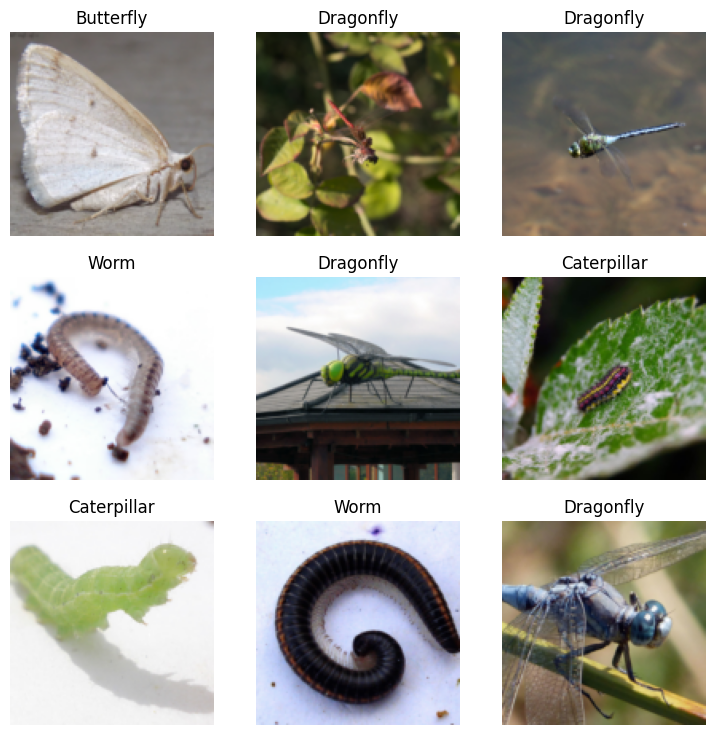

In [ ]:
from fastai.vision.all import *
from fastai.vision import widgets
#from ipywidgets import widgets

path = Path("train")
#fls = get_image_files(path)
#failed = verify_images(path)
if not path.exists() or not any(path.iterdir()):
    print(f"Error: The directory '{path}' does not exist or is empty. Please check your data download process.")
else:
    # Verify images and remove any corrupted ones
    failed = verify_images(get_image_files(path))
    print(f"Found {len(failed)} corrupted images. Removing them...")
    failed.map(Path.unlink)

#Data block
dls = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128) #224
).dataloaders(path, bs=32)

# Dataset
dls.train.show_batch()
# O'qitish
learner = cnn_learner(dls, resnet34, metrics=accuracy)
learner.fine_tune(4)

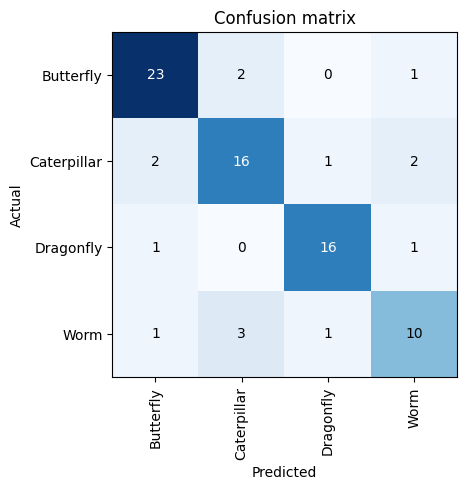

In [ ]:
interp = ClassificationInterpretation.from_learner(learner)
interp.plot_confusion_matrix()

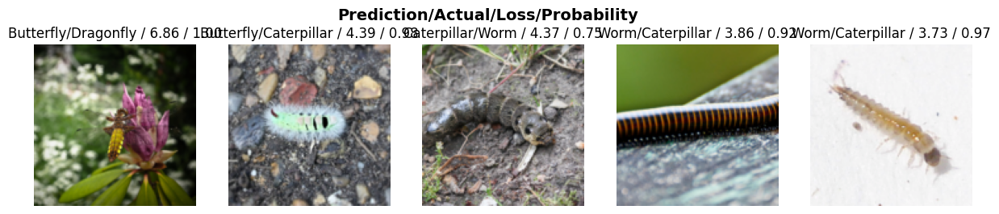

In [ ]:
interp.plot_top_losses(5, nrows=1)

In [ ]:
upload = widgets.FileUpload()
upload

FileUpload(value={}, description='Upload')

Bashorat: Worm
Ehtimollik: 100.0%


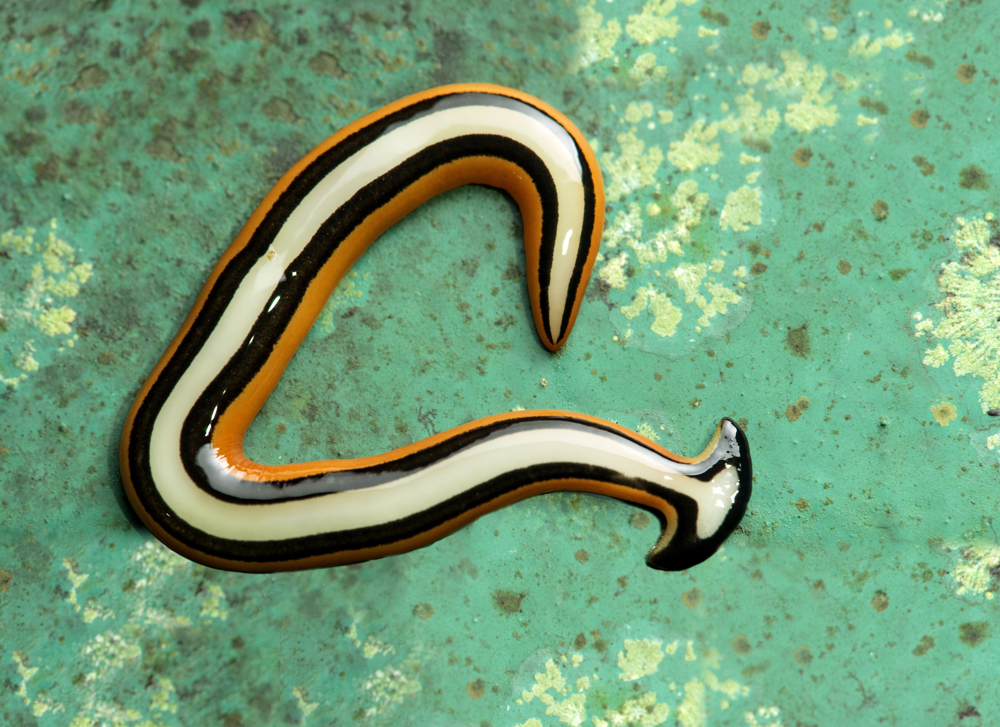

In [ ]:
img = PILImage.create(upload.data[0]) #-1
pred, pred_idx, probs = learner.predict(img)
print(f"Bashorat: {pred}")
print(f"Ehtimollik: {probs[pred_idx]*100:.1f}%")
img

In [ ]:
learner.export('cnn-classification-model.pkl')

In [ ]:
model = load_learner('cnn-classification-model.pkl')
model.predict(img)

('Worm', tensor(3), tensor([6.5652e-07, 1.5540e-05, 5.6684e-06, 9.9998e-01]))